# import

In [1]:
import pandas as pd
import xml.etree.ElementTree as ET
from astropy.io import fits

from astropy.io.votable import parse
from astropy.io.votable import parse_single_table
from astropy.io.votable.tree import VOTableFile, Resource, Table, Field
from astropy.io import fits


from scipy.stats.stats import pearsonr
from scipy.stats import spearmanr#

import matplotlib as mpl
import matplotlib.pyplot as plt
from pylab import cm

from collections import OrderedDict
from adjustText import adjust_text

%matplotlib inline
%config InlineBackend.figure_format='svg'
# Edit the font, font size, and axes width
mpl.rcParams['font.family'] = 'Avenir'
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2

%matplotlib inline
%config InlineBackend.figure_format = "retina"
from matplotlib import rcParams
#rcParams["savefig.dpi"] = 300

In [2]:
#from adjustText import adjust_text
import matplotlib as mpl
def set_ax_tick(ax):
    ax.xaxis.set_tick_params(which='major', size=10, width=2, direction='in', top='on',)
    ax.xaxis.set_tick_params(which='minor', size=5, width=2, direction='in', top='on')
    ax.yaxis.set_tick_params(which='major', size=10, width=2, direction='in', right='on')
    ax.yaxis.set_tick_params(which='minor', size=5, width=2, direction='in', right='on')

def set_ax_locator(ax,xma=1,xmi=0.2,yma=1,ymi=0.2):
    ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(xma))
    ax.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(xmi))
    ax.yaxis.set_major_locator(mpl.ticker.MultipleLocator(yma))
    ax.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(ymi)) 

In [3]:
def drop_index(data):
    data=data.reset_index(drop=True)
    return data

# calc_power_law

In [4]:
from scipy.optimize import least_squares, curve_fit
from scipy.stats import f

In [5]:
def calc_power_law(freq,S0,alpha):
    S = S0 * (freq) ** alpha
    return S

def alpha_calc(data,freq_label='frequency',flux_label='flux',rms_label='rms'):    
    #Get lightcurve values
    freqs = data[freq_label]
    flux = data[flux_label]
    flux_errs = data[rms_label]
    
    #Use the scipy curve_fit algorithm to calculate the best fit value
    popt, pcov = curve_fit(calc_power_law, freqs, flux ,sigma=flux_errs, p0=(50,-0.61),absolute_sigma=True)
    
    alpha = popt[1] #Best-fit spectral index
    alpha_err = np.sqrt(np.diag(pcov))[1] #Uncertainty in alpha
    
    return alpha, alpha_err

def scale_data(data, alpha, alpha_err, ref_freq=5.0,freq_label='frequency',flux_label='flux',rms_label='rms'):#
    #calculate a scaling factor for the flux density and uncertainty
    f_scale = (ref_freq/data[freq_label])**alpha
    rms_scale = np.abs(f_scale*np.log(ref_freq/data[freq_label])*alpha_err)
    
    #scale the flux and uncertainty - don't forget to add errors in quadrature
    scaled_flux = data[flux_label] * f_scale
    scaled_rms = np.abs(scaled_flux) * np.sqrt((data[rms_label]/data[flux_label])**2 + (rms_scale/f_scale)**2)
    
    #Add two new columns to the data
    data['scaled_flux'] = scaled_flux
    data['scaled_rms'] = scaled_rms
    
    return data

sel_data = data#[data['delta_t'] == 162.89]
alpha, alpha_err = alpha_calc(sel_data)
print("alpha = %.2f+/-%.2f"%(alpha, alpha_err))

In [ ]:
def plot_data(ax, sm, data, scaled=False, **kwargs):
    telescope_marker_dict = {'VLA':'s', 'ATCA':'o', 'GMRT':'d'}
    
    
    for row in data:
        #Loop over each row of the data, set the marker colour based on frequency and the marker style based on telescope
        freq = row['frequency']
        colorval = sm.to_rgba(freq) #Set the marker colour based on observing frequency
        
        telescope = row['telescope']
        marker = telescope_marker_dict[telescope] #Set the marker based on telescope
        
        #Are we plotting the original flux density values? Or the scaled values?
        if scaled:
            flux = row['scaled_flux']
            rms = row['scaled_rms']
        else:
            flux = row['flux']
            rms = row['rms']
        
        ax.errorbar(row['delta_t'], flux, rms, linestyle='', marker=marker, c=colorval, **kwargs) #Plot the flux density (with uncertainty) on the provided axis
    return

def cmap_setup(cmap='viridis', min_freq=0, max_freq=17):
    '''
    This function will set up a scalar map for you to colour your markers by frequency
    '''
    freq_cmap = plt.cm.get_cmap(cmap)
    
    cNorm  = colors.Normalize(vmin=min_freq, vmax=max_freq)
    scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=cmap)
    sm = scalarMap
    sm._A = []
    
    return sm    
    
def make_plot(data, scaled=False, model=None, params=None, tvals=np.arange(10,400), plot_models=False):
    fig = plt.figure(figsize=(10,6))
    ax = fig.add_subplot(111)
    
    #Get the scalar map, plot the data using the plot_data function above
    sm = cmap_setup()
    plot_data(ax, sm, data, scaled=scaled)
    
    
    #Set up a colourbar
    cbar = fig.colorbar(sm,fraction=0.046, pad=0.04)
    cbar.set_label('Frequency (GHz)')
    
    #Set axis scales to log
    ax.set_xscale('log')
    ax.set_yscale('log')
    
    #Label axes, set axis limits etc.
    ax.set_xlabel('Time (days)')
    if scaled:
        ax.set_ylabel('Scaled Flux Density ($\mu$Jy)')
    else:
        ax.set_ylabel('Flux Density ($\mu$Jy)')
        
    if model:
        plot_model(model, params, tvals, ax)
    
    if plot_models:
        plot_physical_models(ax)
    
    ax.set_xlim(10,300)
    
make_plot(data)

## cosmology

In [6]:
from astropy.cosmology import FlatLambdaCDM,Planck13,Planck15,z_at_value
from astropy import units as u
from astropy.cosmology import LambdaCDM

#cosmo = LambdaCDM(H0=70, Om0=0.3, Ode0=0.7)
cosmo = LambdaCDM(H0=73, Om0=0.27, Ode0=0.73)
#cosmo=FlatLambdaCDM(H0=73,Om0=0.3)

# gleamdata

In [54]:
gleam=fits.open('/Volumes/ExtremeSSD/Papers_Project/mwa_catalog_paper/gleam_survey/GLEAM_EGC_v2.fits')
gleamdata=gleam[1].data

In [55]:
gleamdata.columns

ColDefs(
    name = 'Name'; format = '20A'
    name = 'background_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'local_rms_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'ra_str'; format = '11A'; unit = 'h:m:s'
    name = 'dec_str'; format = '12A'; unit = 'd:m:s'
    name = 'RAJ2000'; format = 'E'; unit = 'deg'
    name = 'err_RAJ2000'; format = 'D'; unit = 'deg'
    name = 'DEJ2000'; format = 'E'; unit = 'deg'
    name = 'err_DEJ2000'; format = 'D'; unit = 'deg'
    name = 'peak_flux_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'err_peak_flux_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'int_flux_wide'; format = 'E'; unit = 'Jy'
    name = 'err_int_flux_wide'; format = 'E'; unit = 'Jy'
    name = 'a_wide'; format = 'E'; unit = 'arcsec'
    name = 'err_a_wide'; format = 'E'; unit = 'arcsec'
    name = 'b_wide'; format = 'E'; unit = 'arcsec'
    name = 'err_b_wide'; format = 'E'; unit = 'arcsec'
    name = 'pa_wide'; format = 'E'; unit = 'deg'
    name = 'err_pa_wide'; form

# Spectral Variability of Radio Sources at Low Frequencies 2012.01842.pdf

In [7]:
#from astropy.io.votable import parse_single_table
from astropy.table import Table

mwa_spectral_var_path='/Users/brettlv/blog/IHEP_sync/data/data_mwa/Spectral_variability_of_radio_sources_at_low_frequencies——staa3795_supplemental_files/suuplementary_table_master_population.votable'
#mwa_spectral_var_votable = parse(mwa_spectral_var_path)
#mwa_spectral_var_table = parse_single_table(mwa_spectral_var_path).to_table()
mwa_spectral_var_table = Table.read(mwa_spectral_var_path)

In [ ]:
114.8251408   1.6179497

In [8]:
mwa_spectral_var_table_select_PKS0736=mwa_spectral_var_table[abs(mwa_spectral_var_table["RAJ2000"]-114.825)<5]
mwa_spectral_var_table_select_PKS0736=mwa_spectral_var_table_select_PKS0736[abs(mwa_spectral_var_table_select_PKS0736["DEJ2000"]-1.617)<5]

In [9]:
mwa_spectral_var_table_select_PKS0736

GLEAM_Name,RAhms,Decdms,RAJ2000,e_RAJ2000,DEJ2000,e_DEJ2000,int_flux_wide_yr1,e_int_flux_wide_yr1,local_rms_wide_yr1,a_wide_yr1,b_wide_yr1,psf_a_wide_yr1,psf_b_wide_yr1,int_flux_wide_yr2,e_int_flux_wide_yr2,local_rms_wide_yr2,a_wide_yr2,b_wide_yr2,psf_a_wide_yr2,psf_b_wide_yr2,local_rms_107_yr1,S_107_yr1,e_S_107_yr1,local_rms_115_yr1,S_115_yr1,e_S_115_yr1,local_rms_123_yr1,S_123_yr1,e_S_123_yr1,local_rms_130_yr1,S_130_yr1,e_S_130_yr1,local_rms_143_yr1,S_143_yr1,e_S_143_yr1,local_rms_150_yr1,S_150_yr1,e_S_150_yr1,local_rms_158_yr1,S_158_yr1,e_S_158_yr1,local_rms_166_yr1,S_166_yr1,e_S_166_yr1,local_rms_174_yr1,S_174_yr1,e_S_174_yr1,local_rms_181_yr1,S_181_yr1,e_S_181_yr1,local_rms_189_yr1,S_189_yr1,e_S_189_yr1,local_rms_197_yr1,S_197_yr1,e_S_197_yr1,local_rms_204_yr1,S_204_yr1,e_S_204_yr1,local_rms_212_yr1,S_212_yr1,e_S_212_yr1,local_rms_220_yr1,S_220_yr1,e_S_220_yr1,local_rms_227_yr1,S_227_yr1,e_S_227_yr1,local_rms_107_yr2,S_107_yr2,e_S_107_yr2,local_rms_115_yr2,S_115_yr2,e_S_115_yr2,local_rms_123_yr2,S_123_yr2,e_S_123_yr2,local_rms_130_yr2,S_130_yr2,e_S_130_yr2,local_rms_143_yr2,S_143_yr2,e_S_143_yr2,local_rms_150_yr2,S_150_yr2,e_S_150_yr2,local_rms_158_yr2,S_158_yr2,e_S_158_yr2,local_rms_166_yr2,S_166_yr2,e_S_166_yr2,local_rms_174_yr2,S_174_yr2,e_S_174_yr2,local_rms_181_yr2,S_181_yr2,e_S_181_yr2,local_rms_189_yr2,S_189_yr2,e_S_189_yr2,local_rms_197_yr2,S_197_yr2,e_S_197_yr2,local_rms_204_yr2,S_204_yr2,e_S_204_yr2,local_rms_212_yr2,S_212_yr2,e_S_212_yr2,local_rms_220_yr2,S_220_yr2,e_S_220_yr2,local_rms_227_yr2,S_227_yr2,e_S_227_yr2,S_076,e_S_076,S_084,e_S_084,S_092,e_S_092,S_099,e_S_099,S_tgss,e_S_tgss,S_mrc,S_sumss,S_nvss,S_vlssr,alpha_low_yr1,e_alpha_low_yr1,alpha_high_yr1,e_alpha_high_yr1,quad_curve_yr1,e_quad_curve_yr1,redchisq_low_yr1,redchisq_high_yr1,redchisq_quad_yr1,alpha_low_yr2,e_alpha_low_yr2,alpha_high_yr2,e_alpha_high_yr2,quad_curve_yr2,e_quad_curve_yr2,redchisq_low_yr2,redchisq_high_yr2,redchisq_quad_yr2,VIP,MOSS,variable_flag,peaked_spectrum_source_flag,persistent_pss_flag,MOSS_class,pss_class_yr1,pss_class_yr2,RAJ2000_NVSS,DEJ2000_NVSS,RA_WISE,Dec_WISE,w1mpro,w2mpro,w3mpro,w4mpro,Class,z
,,,,,,,Jy,Jy,Jy.beam-1,"""","""","""","""",Jy,Jy,Jy.beam-1,"""","""","""","""",Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy.beam-1,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,mag,mag,mag,mag,,
str20,str11,str12,float64,float64,float64,float64,str5,str5,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float

In [10]:
len(mwa_spectral_var_table)

21558

## mwa_spectral_var_table.colnames

In [11]:
mwa_spectral_var_table.colnames

['GLEAM_Name',
 'RAhms',
 'Decdms',
 'RAJ2000',
 'e_RAJ2000',
 'DEJ2000',
 'e_DEJ2000',
 'int_flux_wide_yr1',
 'e_int_flux_wide_yr1',
 'local_rms_wide_yr1',
 'a_wide_yr1',
 'b_wide_yr1',
 'psf_a_wide_yr1',
 'psf_b_wide_yr1',
 'int_flux_wide_yr2',
 'e_int_flux_wide_yr2',
 'local_rms_wide_yr2',
 'a_wide_yr2',
 'b_wide_yr2',
 'psf_a_wide_yr2',
 'psf_b_wide_yr2',
 'local_rms_107_yr1',
 'S_107_yr1',
 'e_S_107_yr1',
 'local_rms_115_yr1',
 'S_115_yr1',
 'e_S_115_yr1',
 'local_rms_123_yr1',
 'S_123_yr1',
 'e_S_123_yr1',
 'local_rms_130_yr1',
 'S_130_yr1',
 'e_S_130_yr1',
 'local_rms_143_yr1',
 'S_143_yr1',
 'e_S_143_yr1',
 'local_rms_150_yr1',
 'S_150_yr1',
 'e_S_150_yr1',
 'local_rms_158_yr1',
 'S_158_yr1',
 'e_S_158_yr1',
 'local_rms_166_yr1',
 'S_166_yr1',
 'e_S_166_yr1',
 'local_rms_174_yr1',
 'S_174_yr1',
 'e_S_174_yr1',
 'local_rms_181_yr1',
 'S_181_yr1',
 'e_S_181_yr1',
 'local_rms_189_yr1',
 'S_189_yr1',
 'e_S_189_yr1',
 'local_rms_197_yr1',
 'S_197_yr1',
 'e_S_197_yr1',
 'local_rms_20

# mwa_spectral_var_path_dir

In [12]:
mwa_spectral_var_path_dir='/Users/brettlv/blog/IHEP_sync/data/data_mwa/Spectral_variability_of_radio_sources_at_low_frequencies——staa3795_supplemental_files/Appendix/'

## mwa_spectral_var_list

In [13]:
import os
mwa_spectral_var_list=[]
names=os.listdir(mwa_spectral_var_path_dir)
for i in names:
    if i.endswith('pdf'):
        mwa_spectral_var_list.append(i[:-4])

In [14]:
len(mwa_spectral_var_list)

323

In [15]:
mwa_spectral_var_list

['GLEAM_J000353-382707',
 'GLEAM_J000402-101507',
 'GLEAM_J000404-114858',
 'GLEAM_J000533-252819',
 'GLEAM_J000619-424524',
 'GLEAM_J001052-415316',
 'GLEAM_J001502-181238',
 'GLEAM_J001513-472706',
 'GLEAM_J001525-361620',
 'GLEAM_J001942-303118',
 'GLEAM_J002223-070230',
 'GLEAM_J002251-435218',
 'GLEAM_J002257-464809',
 'GLEAM_J002523-222744',
 'GLEAM_J002552-144111',
 'GLEAM_J003119-165202',
 'GLEAM_J003152-311437',
 'GLEAM_J003244-144112',
 'GLEAM_J003246-293107',
 'GLEAM_J003454-230328',
 'GLEAM_J003616-430939',
 'GLEAM_J004209-441404',
 'GLEAM_J004342-033142',
 'GLEAM_J004451-492745',
 'GLEAM_J004644-052157',
 'GLEAM_J004839-294718',
 'GLEAM_J005021-045218',
 'GLEAM_J005052-442841',
 'GLEAM_J005315-070232',
 'GLEAM_J005351-491402',
 'GLEAM_J005409-475208',
 'GLEAM_J005446-090207',
 'GLEAM_J005459-302204',
 'GLEAM_J005511-121754',
 'GLEAM_J005754-493154',
 'GLEAM_J010316-322550',
 'GLEAM_J010626-271803',
 'GLEAM_J010656-094638',
 'GLEAM_J010834-103346',
 'GLEAM_J010957-331336',


In [16]:
len(mwa_spectral_var_table)

21558

In [17]:
mwa_spectral_var_table.colnames

['GLEAM_Name',
 'RAhms',
 'Decdms',
 'RAJ2000',
 'e_RAJ2000',
 'DEJ2000',
 'e_DEJ2000',
 'int_flux_wide_yr1',
 'e_int_flux_wide_yr1',
 'local_rms_wide_yr1',
 'a_wide_yr1',
 'b_wide_yr1',
 'psf_a_wide_yr1',
 'psf_b_wide_yr1',
 'int_flux_wide_yr2',
 'e_int_flux_wide_yr2',
 'local_rms_wide_yr2',
 'a_wide_yr2',
 'b_wide_yr2',
 'psf_a_wide_yr2',
 'psf_b_wide_yr2',
 'local_rms_107_yr1',
 'S_107_yr1',
 'e_S_107_yr1',
 'local_rms_115_yr1',
 'S_115_yr1',
 'e_S_115_yr1',
 'local_rms_123_yr1',
 'S_123_yr1',
 'e_S_123_yr1',
 'local_rms_130_yr1',
 'S_130_yr1',
 'e_S_130_yr1',
 'local_rms_143_yr1',
 'S_143_yr1',
 'e_S_143_yr1',
 'local_rms_150_yr1',
 'S_150_yr1',
 'e_S_150_yr1',
 'local_rms_158_yr1',
 'S_158_yr1',
 'e_S_158_yr1',
 'local_rms_166_yr1',
 'S_166_yr1',
 'e_S_166_yr1',
 'local_rms_174_yr1',
 'S_174_yr1',
 'e_S_174_yr1',
 'local_rms_181_yr1',
 'S_181_yr1',
 'e_S_181_yr1',
 'local_rms_189_yr1',
 'S_189_yr1',
 'e_S_189_yr1',
 'local_rms_197_yr1',
 'S_197_yr1',
 'e_S_197_yr1',
 'local_rms_20

In [ ]:
mwa_spectral_var_table['MOSS'][0]

number_of_known_class=0
for index,name in enumerate(mwa_spectral_var_table['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)
    if name_new in mwa_spectral_var_list:
        if mwa_spectral_var_table['Class'][index]!= 'nan': 
            number_of_known_class+=1
            print(index,name,mwa_spectral_var_table['Class'][index],mwa_spectral_var_table['z'][index])
print(number_of_known_class)            

In [ ]:
print('MOSS >= 36.7')
print('index','name','RAJ2000','DEJ2000','class','z','MOSS')
for index,name in enumerate(mwa_spectral_var_table['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)
    if name_new in mwa_spectral_var_list:
        if float(mwa_spectral_var_table['MOSS'][index]) >=36.7:
            if mwa_spectral_var_table['Class'][index]!= 'nan': 
                print(index,name,mwa_spectral_var_table['RAJ2000'][index],mwa_spectral_var_table['DEJ2000'][index],mwa_spectral_var_table['Class'][index],'z:',mwa_spectral_var_table['z'][index],'moss:',mwa_spectral_var_table['MOSS'][index])

In [ ]:
0.1*10**26*

In [ ]:
for index,name in enumerate(mwa_spectral_var_table['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)
    if name_new in mwa_spectral_var_list:
        if mwa_spectral_var_table['Class'][index]!= 'nan': 
            print(index,name,mwa_spectral_var_table['RAJ2000'][index],mwa_spectral_var_table['DEJ2000'][index],mwa_spectral_var_table['Class'][index],'z:',mwa_spectral_var_table['z'][index])

mwa_spectral_var_table_mossgt36dot7=mwa_spectral_var_table[float(mwa_spectral_var_table['MOSS'])>=36.7]

In [ ]:
len(mwa_spectral_var_table_mossgt36dot7)

In [ ]:
mwa_spectral_var_table_mossgt36dot7

# MWA_spec_var_crossmatch_with_NED

from astroquery.ned import Ned
import astropy.units as u
from astropy import coordinates
co = coordinates.SkyCoord(ra=56.38, dec=38.43,
                         unit=(u.deg, u.deg), frame='fk4')
result_table = Ned.query_region(co, radius=0.1 * u.deg, equinox='B1950.0')
print(result_table)


In [ ]:
for index,name in enumerate(mwa_spectral_var_table['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)
    if name_new in mwa_spectral_var_list:
        if mwa_spectral_var_table['Class'][index]!= 'nan': 
             #print(index,name,mwa_spectral_var_table['RAJ2000'][index],mwa_spectral_var_table['DEJ2000'][index],mwa_spectral_var_table['Class'][index],'z:',mwa_spectral_var_table['z'][index])
            if float(mwa_spectral_var_table['MOSS'][index]) >=36.7:       
                co = coordinates.SkyCoord(ra=mwa_spectral_var_table['RAJ2000'][index], dec=mwa_spectral_var_table['DEJ2000'][index],
                         unit=(u.deg, u.deg), frame='fk5')
                result_table = Ned.query_region(co, radius=100 * u.arcsec, equinox='J2000.0')
                print(name,result_table)


# MWA_spec_var_crossmatch_with_WISE

# mwa_spectral_var_table_323

mwa_spectral_var_table.add_column(0,name='select')

In [19]:
#print('MOSS >= 36.7')
#print('index','name','RAJ2000','DEJ2000','class','z','MOSS')
for index,name in enumerate(mwa_spectral_var_table['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)
    if name_new in mwa_spectral_var_list:
        mwa_spectral_var_table['select'][index]=1

In [20]:
mwa_spectral_var_table_323=mwa_spectral_var_table[mwa_spectral_var_table['select']==1]

In [21]:
len(mwa_spectral_var_table_323)

323

## mwa_spectral_var_table_323.colnames

In [22]:
mwa_spectral_var_table_323.add_column(0.0,name='MOSS_float')
mwa_spectral_var_table_323.add_column(0.0,name='int_flux_wide_yr1_float')
mwa_spectral_var_table_323.add_column(0.0,name='int_flux_wide_yr2_float')

mwa_spectral_var_table_323.colnames

In [24]:
len(mwa_spectral_var_table_323)

323

In [23]:
for index,name in enumerate(mwa_spectral_var_table_323['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)   
    mwa_spectral_var_table_323['MOSS_float'][index]=float(mwa_spectral_var_table_323['MOSS'][index])
    mwa_spectral_var_table_323['int_flux_wide_yr1_float'][index]=float(mwa_spectral_var_table_323['int_flux_wide_yr1'][index])
    mwa_spectral_var_table_323['int_flux_wide_yr2_float'][index]=float(mwa_spectral_var_table_323['int_flux_wide_yr2'][index])



## mosslt36dot7

In [25]:
mwa_spectral_var_table_323_mosslt36dot7=mwa_spectral_var_table_323[mwa_spectral_var_table_323['MOSS_float']<36.7]

In [26]:
len(mwa_spectral_var_table_323_mosslt36dot7)

272

In [ ]:
pwd

In [ ]:
mwa_spectral_var_table_323_mosslt36dot7.write('mwa_spectral_var_table_323_mosslt36dot7.csv')

## mossgt36dot7

In [27]:
mwa_spectral_var_table_323_mossgt36dot7=mwa_spectral_var_table_323[mwa_spectral_var_table_323['MOSS_float']>=36.7]

In [28]:
len(mwa_spectral_var_table_323_mossgt36dot7)

51

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7.write('mwa_spectral_var_table_323_mossgt36dot7.csv')

In [ ]:
pwd

## mwa_spectral_var_table_323_redshift

In [29]:
mwa_spectral_var_table_323_redshift=mwa_spectral_var_table_323[mwa_spectral_var_table_323['z']>0]

In [30]:
len(mwa_spectral_var_table_323_redshift)

59

## mwa_spectral_var_table_323_mossgt36dot7_redshift

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift=mwa_spectral_var_table_323_mossgt36dot7[mwa_spectral_var_table_323_mossgt36dot7['z']>0]

In [ ]:
len(mwa_spectral_var_table_323_mossgt36dot7_redshift)

In [ ]:
d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift=cosmo.luminosity_distance(mwa_spectral_var_table_323_mossgt36dot7_redshift['z']).to(u.cm).value



mwa_spectral_var_table_323_redshift['int_flux_wide_yr1']

In [ ]:
Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift=4*np.pi*d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift**2*(1+mwa_spectral_var_table_323_mossgt36dot7_redshift['z'])**(-mwa_spectral_var_table_323_mossgt36dot7_redshift['alpha_low_yr1']-1)*mwa_spectral_var_table_323_mossgt36dot7_redshift['S_204_yr1']*1.0e-23*204.0e6#204MHz


In [ ]:
Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift=4*np.pi*d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift**2*(1+mwa_spectral_var_table_323_mossgt36dot7_redshift['z'])**(-mwa_spectral_var_table_323_mossgt36dot7_redshift['alpha_low_yr2']-1)*mwa_spectral_var_table_323_mossgt36dot7_redshift['S_204_yr2']*1.0e-23*204.0e6#204MHz


In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift['Pyr1_204MHz']=Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift
mwa_spectral_var_table_323_mossgt36dot7_redshift['Pyr2_204MHz']=Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift


In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift['Pjet_yr1_from204MHz']=0.64*(np.log10(Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift)-40)+1.54+42

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift['Pjet_yr2_from204MHz']=0.64*(np.log10(Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift)-40)+1.54+42

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift['GLEAM_Name','RAJ2000','DEJ2000','Pjet_yr1_from204MHz','Pjet_yr2_from204MHz','z']


mwa_spectral_var_table_323_mossgt36dot7_redshift['z']

## mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss=mwa_spectral_var_table_323_mossgt36dot7_redshift[mwa_spectral_var_table_323_mossgt36dot7_redshift['S_nvss']>0]


In [ ]:
len(mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss)

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['GLEAM_Name']

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss.colnames

In [ ]:
Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss=4*np.pi*d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss**2*(1+mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['z'])**(-mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['alpha_high_yr1']-1)*mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['S_nvss']*1.0e-23*1.4e9#GHz


Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss=4*np.pi*d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss**2*(1+mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['z'])**(-mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['alpha_high_yr2']-1)*mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['S_nvss']*1.0e-23*1.4e9#GHz

mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['Pyr1_1.4']=Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss

mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['Pyr2_1.4']=Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss


mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['Pjet_yr1_from_1.4']=0.75*(np.log10(Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss)-40)+1.91+42

mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['Pjet_yr2_from_1.4']=0.75*(np.log10(Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss)-40)+1.91+42



In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['GLEAM_Name','RAJ2000','DEJ2000','Pjet_yr1_from_1.4','Pjet_yr2_from_1.4','z']


In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['GLEAM_Name','Pyr1_204MHz','Pyr1_1.4','Pjet_yr1_from204MHz','Pjet_yr1_from_1.4','z']


## ned 
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss

In [ ]:
for index,name in enumerate(mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['GLEAM_Name']):
    name_new= name.replace(' ','_')
    #print(name_new)
    if name_new in mwa_spectral_var_list:
        co = coordinates.SkyCoord(ra=mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['RAJ2000'][index], dec=mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['DEJ2000'][index],
                 unit=(u.deg, u.deg), frame='fk5')
        result_table = Ned.query_region(co, radius=100 * u.arcsec, equinox='J2000.0')
        print(index,name,co.ra.deg,co.dec.deg)
        for table_i in result_table:
            print(table_i)


In [ ]:
d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss=cosmo.luminosity_distance(mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['z']).to(u.cm).value



In [ ]:
d_cm_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss

In [ ]:
mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss['S_nvss']

# Power radio

 $$P_{ν_0} = 4 π D_L^2 (1 + z)^{-α−1}S_{ν_0} ν_0$$
 
 $$S_v = a v^{α}$$

##  average cavity power, Pcav,

To estimate average cavity power, Pcav, the energy of each cavity was divided by an estimate of its age. For compatibility with B08, we give results derived assuming that the age of the cavities is approximated by the buoyant rise time, tbuoy (Churazov et al. 2001; Bru ̈ggen 2003). Because the mechanical power estimated from the cavities greatly exceeds the synchrotron power of the radio source, we assume that Pcav = Pjet. Further, Pcav does not include energy channeled into shocks (e.g., Forman et al. 2007; Baldi et al. 2009a), which can exceed the energy in cavities (e.g., Nulsen et al. 2005). The cavity power estimates were summed for all the cavities in each system to obtain an estimate of the average AGN outburst power. Because the uncertainties are large (chiefly due to the uncertain volume estimates), errors are propagated in log space, assuming that the uncertainties in ambient pressure, cavity volume, and cavity age are independent of one another.

$$\mathrm{log P_{cav}} = 0.75(\pm 0.14) \mathrm{log} P_{1.4} + 1.91(±0.18) $$

$$\mathrm{log P_{cav}} = 0.64(\pm 0.09) \mathrm{log} P_{200-400} + 1.54(±0.12) $$

where Pcav is in units 10^42 erg s−1 and P1.4 and P200−400 are in units 10^40 erg s−1. The scatter for each relation is σ1.4 = 0.78 dex and σ200−400 = 0.61 dex, and the respective correlation coefficients are r1.4 = 0.72 and r200−400 = 0.81.

## Delta P

In [ ]:
0.75*(np.log10(Pyr1_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss)-40)-0.75*(np.log10(Pyr2_mwa_spectral_var_table_323_mossgt36dot7_redshift_S_nvss)-40)

## plot

In [ ]:
min(mwa_spectral_var_table_323_mossgt36dot7['int_flux_wide_yr1_float']),max(mwa_spectral_var_table_323_mossgt36dot7['int_flux_wide_yr1_float'])

In [ ]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6, 6))
#fig.subplots_adjust(left=0.1, right=0.85, bottom=0.12, top=0.95)
ax=fig.add_subplot(1,1,1)

plot_label='int_flux_wide_yr1_float'
plot_data=mwa_spectral_var_table_323_mossgt36dot7_redshift

counts,bins=np.histogram(plot_data[plot_label],bins=10)

ax.hist(bins[:-1],bins,weights=counts/len(plot_data),
        fill=False,linewidth=2,histtype='step',edgecolor='black',
        label=plot_label)

set_ax_tick(ax)
set_ax_locator(ax,1.0,0.5,0.2,0.1)
#ax.set_xlim(timerangel,timeranger)
#ax.set_xlim(-2.5,2.5)
#ax.set_ylim(20,300)

ax.xaxis.set_tick_params(which='major', size=10, width=2, rotation=45,)
handles, labels = ax.get_legend_handles_labels()
hdl = handles
# remove the errorbars
#hdl = [h[0] for h in handles]
labels_dict=dict(zip(labels, hdl)) #key,values
by_label = OrderedDict(zip(labels, hdl)) 
#by_label=OrderedDict(sorted(labels_dict.items(),key=lambda t:t[0]))
ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.3, 0.99),
          loc=2, numpoints=1,ncol=1,fontsize=11.)

ax.set_ylabel(r'$dN/N$')
#ax.set_xlabel(r'log$L_{bol}(10^{11}L_{\odot})$')

# use them in the legend
#by_label = OrderedDict(zip(labels, handles)) 
#ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.0, 0.9),loc=2, numpoints=1, fontsize=11. )
#ax.semilogy()
#ax.semilogx()
#ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(1000))
#ax.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(500))
#plt.title(r'$\tau$- $L_{bol}$')        

#fig.savefig('%s/tau_L_correlation.png'%png_dir,dpi=400,transparent=False,bbox_inches='tight')

# common name variable source candidate

In [ ]:
[LHL2013]

1RXS J013240.9-165451

[HB89] 0130-171

PKS 2327-376

PKS 2145-17

In [ ]:
A search for long-time-scale, low-frequency radio transients

We present a search for transient and highly variable sources at low radio frequencies (150– 200 MHz) that explores long time-scales of 1–3 yr. 

We analyse the third candidate and show it is likely to be real, with a flux density of 182 ± 26 mJy at 147.5 MHz. This gives a transient surface density of ρ = (6.2 ± 6) × 10−5 deg−2. We present initial follow-up observations and discuss possible causes for this candidate. The small number of spurious sources from this search demonstrates the high reliability of these two new low-frequency radio catalogues.

In [ ]:
TGSSADR J183304.4−384046

In [ ]:
Figure5. TGSSADR1(left)andGLEAM(right)imagesofthetransientcandidateTGSSADRJ183304.4−384046

In [ ]:
26.2*6144/3600

In [ ]:
{Extragalactic Peaked-spectrum Radio Sources at Low Frequencies}b

In [ ]:
Figure 24. The spectra of six extreme peaked-spectrum sources that have αthick > 2.5

GLEAM J001513- 472706, GLEAM J074211-673309, and GLEAM J144815- 162024 were observed by the MWA twice with a gap of three months, and GLEAM J211949-343936 and GLEAM J213024- 434819 were observed twice with a gap of nine months. There is no evidence of variability in the low-frequency spectra for any of the sources. Unfortunately, the best ESE candidate, GLEAM J100256-354157, was only observed once during the GLEAM survey.

In [ ]:
NVSS J142750-321515

PKS 0735+178




In [ ]:
sn2020tcw dec在39.94mwa数据搜不到，应该太北了

# crossmatch with G0044

In [33]:
import os
import sys
from time import time

import numpy as np
from matplotlib import pyplot as plt
from astropy.visualization import hist
from astroML.datasets import fetch_imaging_sample, fetch_sdss_S82standards
from astroML.crossmatch import crossmatch_angular

In [31]:
selfcal_1207652304=Table.read('/Users/brettlv/blog/IHEP_sync/data/data_mwa/PKS0736/sources_table/stokes-1207652304-selfcal_3-I_out_comp.fits')

In [34]:
selfcal_1207652304.colnames

['island',
 'source',
 'background',
 'local_rms',
 'ra_str',
 'dec_str',
 'ra',
 'err_ra',
 'dec',
 'err_dec',
 'peak_flux',
 'err_peak_flux',
 'int_flux',
 'err_int_flux',
 'a',
 'err_a',
 'b',
 'err_b',
 'pa',
 'err_pa',
 'flags',
 'residual_mean',
 'residual_std',
 'uuid',
 'psf_a',
 'psf_b',
 'psf_pa']

selfcal_1207652304

mwa_spectral_var_table_323.colnames

In [40]:
len(selfcal_1207652304),len(mwa_spectral_var_table_323)

(2643, 323)

selfcal_1207652304['ra']

mwa_spectral_var_table_323['RAJ2000']

In [46]:
imX = np.empty((len(selfcal_1207652304), 2), dtype=np.float64)
imX[:, 0] = selfcal_1207652304['ra']
imX[:, 1] = selfcal_1207652304['dec']

stX = np.empty((len(mwa_spectral_var_table_323), 2), dtype=np.float64)
stX[:, 0] = mwa_spectral_var_table_323['RAJ2000']
stX[:, 1] = mwa_spectral_var_table_323['DEJ2000']


# crossmatch catalogs
#max_radius = 1. / 3600  # 1 arcsec
max_radius = 100/3600  # 1 degree

dist, ind = crossmatch_angular(stX, imX, max_radius)
match = ~np.isinf(dist)# '~np.isinf' vs 'np.isinf'

dist_match = dist[match]

dist_match *= 3600 #convert to arcsec

In [56]:
plt.scatter(selfcal_1207652304['ra'],selfcal_1207652304['dec'],color='red')
plt.scatter(mwa_spectral_var_table_323['RAJ2000'],mwa_spectral_var_table_323['DEJ2000'],color='blue',zorder=1)
plt.scatter(mwa_spectral_var_table['RAJ2000'],mwa_spectral_var_table['DEJ2000'],color='grey',zorder=0)
plt.scatter(gleamdata['RAJ2000'],gleamdata['DEJ2000'],color='grey',marker='*',zorder=0)

plt.xlabel('RA')
plt.ylabel('DEC')

Text(0, 0.5, 'DEC')

ValueError: data should have more than three entries

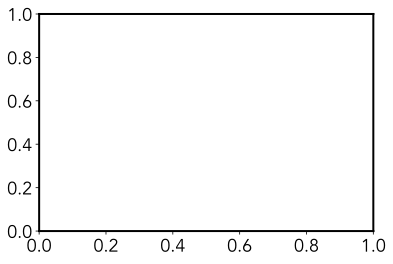

In [37]:


ax = plt.axes()
hist(dist_match, bins='knuth', ax=ax,
     histtype='stepfilled', ec='k', fc='#AAAAAA')
ax.set_xlabel('radius of match (degree)')
ax.set_ylabel('N(r, r+dr)')
ax.text(0.95, 0.95,
        "Total objects: %i\nNumber with match: %i" % (imX.shape[0],
                                                      np.sum(match)),
        ha='right', va='top', transform=ax.transAxes)
ax.set_xlim(0, 100)
plt.show()
